<a href="https://colab.research.google.com/github/syt1298/Lux-ai-reinforcement-learning/blob/main/lux_ai_reinforcement_learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Reinforcement Learning using Q-learning

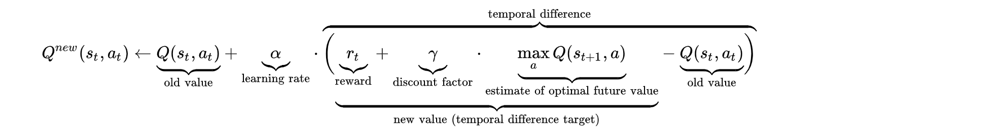

In [ ]:
!pip install kaggle-environments -U

     |████████████████████████████████| 1.2 MB 8.0 MB/s 
     |████████████████████████████████| 69 kB 4.6 MB/s 
  Attempting uninstall: jsonschema
    Found existing installation: jsonschema 2.6.0
    Uninstalling jsonschema-2.6.0:
      Successfully uninstalled jsonschema-2.6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
nbclient 0.5.9 requires jupyter-client>=6.1.5, but you have jupyter-client 5.3.5 which is incompatible.


In [ ]:
!git clone https://github.com/Lux-AI-Challenge/Lux-Design-2021.git

Cloning into 'Lux-Design-2021'...
remote: Enumerating objects: 4279, done.
remote: Counting objects: 100% (2191/2191), done.
remote: Compressing objects: 100% (1036/1036), done.
remote: Total 4279 (delta 1288), reused 1957 (delta 1118), pack-reused 2088
Receiving objects: 100% (4279/4279), 18.49 MiB | 17.42 MiB/s, done.
Resolving deltas: 100% (2530/2530), done.


In [ ]:
!mkdir LUX

In [ ]:
cd LUX

[Errno 2] No such file or directory: 'LUX'
/content/LUX


In [ ]:
!cp -R /content/Lux-Design-2021/kits/python/simple/lux .

In [ ]:
from kaggle_environments import make
from lux.game import Game
from lux.game_map import Cell, RESOURCE_TYPES, Position
from lux.game_objects import Unit
from lux.constants import Constants
from lux.game_constants import GAME_CONSTANTS
from lux import annotate
import math, sys
import numpy as np
import random
from IPython.display import clear_output 
from lux.game import Game
from lux.game_map import Cell, RESOURCE_TYPES
from lux.constants import Constants
from lux.game_constants import GAME_CONSTANTS
from lux import annotate
import math
import numpy as np
import tensorflow as tf
from tensorflow import keras
from keras import layers
import tensorflow_hub as hub
from collections import deque
import random
import math

Loading environment football failed: No module named 'gfootball'


In [ ]:
gamma = 0.95
epsilon = 1.0
epsilon_final = 0.01
epsilon_decay = 0.995
# we declare this global game_state object so that state persists across turns so we do not need to reinitialize it all the time
game_state = None


 # Input and output of the model

In [ ]:
# this is the basic agent definition. At the moment this agent does nothing (and actually will survive for a bit before getting consumed by darkness)
def agent(observation, configuration):
    global game_state
    
    ### Do not edit ###
    if observation["step"] == 0:
        game_state = Game()
        game_state._initialize(observation["updates"])
        game_state._update(observation["updates"][2:])
        game_state.id = observation.player
#         print("new episode")
    else:
        game_state._update(observation["updates"])
    
    actions = []

    ### AI Code goes down here! ### 
    player = game_state.players[observation.player]
    opponent = game_state.players[(observation.player + 1) % 2]
    width, height = game_state.map.width, game_state.map.height
#     print(observation['reward'])

    return actions

we run one episode to take an example of the `game_state`. 

In [ ]:
# run another match but with our empty agent
env = make("lux_ai_2021", configuration={"seed": 562124210, "loglevel": 2}, debug=True)
steps = env.run([agent, agent])

# Strategy
The model will take as input the map of the game(width x height), with all feature of the cells, the output will be a map of cells, for every cell we will predict direction and ability to move, build, and others abilities can be made by the units.

# The input of the model 

In [ ]:
def get_inputs(game_state):
    # Teh shape of the map
    w,h = game_state.map.width, game_state.map.height
    # The map of ressources
    M = [ [0  if game_state.map.map[j][i].resource==None else game_state.map.map[j][i].resource.amount for i in range(w)]  for j in range(h)]
    
    M = np.array(M).reshape((h,w,1))
    
    # The map of units features
    U = [ [[0,0,0,0,0] for i in range(w)]  for j in range(h)]
    units = game_state.players[0].units
    for i in units:
        U[i.pos.y][i.pos.x] = [i.type,i.cooldown,i.cargo.wood,i.cargo.coal,i.cargo.uranium]

    U = np.array(U)
    
    # The map of cities featrues
    e = game_state.players[1].cities
    C = [ [[0,0,0,0] for i in range(w)]  for j in range(h)]
    for k in e:
        citytiles = e[k].citytiles
        for i in citytiles:
            C[i.pos.y][i.pos.x] = [i.cooldown,e[k].fuel,e[k].light_upkeep,e[k].team]

    C = np.array(C)
#     print(M.shape,U.shape,C.shape)
    # stacking all in one array
    E = np.dstack([M,U,C])
    return E

input_shape = get_inputs(game_state).shape
# The shape of input
input_shape 

(32, 32, 10)

# Model

In [ ]:
def get_model(game_state):
    inputs = keras.Input(shape=get_inputs(game_state).shape,name = 'The game map')
    
    # Try to play with the next layers in order to enhance the brean of your agent
    c = layers.Conv2D(8,(1,1),activation = "relu")(inputs)
    c = layers.Conv2D(8,(1,1),activation = "relu")(c)
    c = layers.Conv2D(8,(1,1),activation = "relu")(c)
    
    # The next layer will define the direction among the 5 options, because we can take only one direction we had to use softmax activation
    output1 = layers.Dense(5,activation = "softmax",name ='direction')(c)
    
    # The next layer will define the option token by the unit (move, build,...), because one unit can take only one option we use sotmax activation
    output2 = layers.Dense(3,activation = "softmax",name="option" )(c)
    output = layers.concatenate([output1,output2])
    model = keras.Model(inputs = inputs, outputs = output)
    model.compile(loss='mse', optimizer="adam")
    return model

model =get_model(game_state)
model.summary()

Model: "model_15"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 The game map (InputLayer)      [(None, 32, 32, 10)  0           []                               
                                ]                                                                 
                                                                                                  
 conv2d_45 (Conv2D)             (None, 32, 32, 8)    88          ['The game map[0][0]']           
                                                                                                  
 conv2d_46 (Conv2D)             (None, 32, 32, 8)    72          ['conv2d_45[0][0]']              
                                                                                                  
 conv2d_47 (Conv2D)             (None, 32, 32, 8)    72          ['conv2d_46[0][0]']       

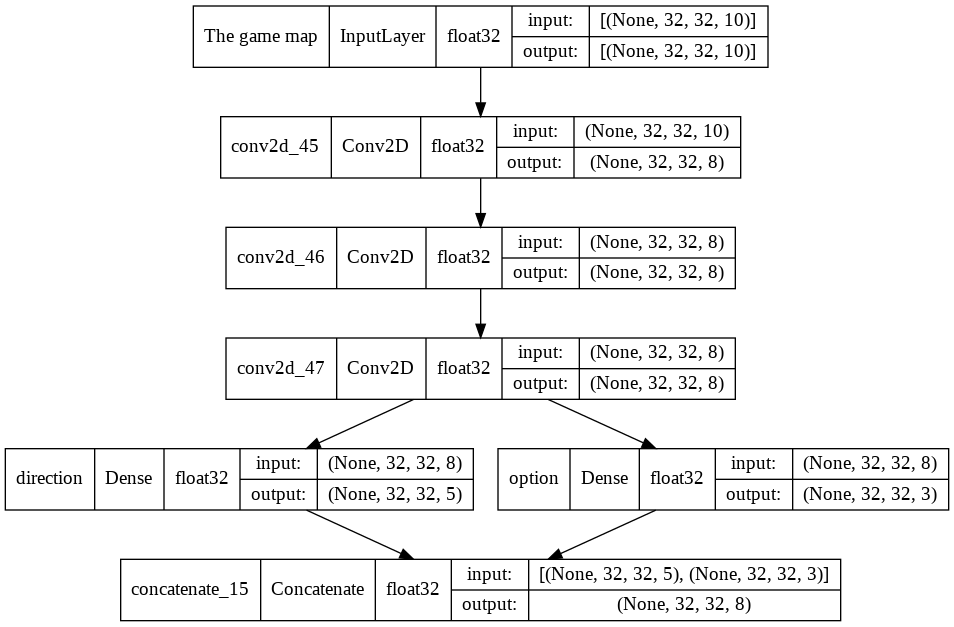

In [ ]:
tf.keras.utils.plot_model(
    model,
    to_file="model.png",
    show_shapes=1,
    show_dtype=1,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=96)

# Predicting actions

In [ ]:
x = get_inputs(game_state)
y = model.predict(np.asarray([x]))[0]
y.shape

(32, 32, 8)

The function will take the units of the game stat and predict the options and directions in case of move option gathered in actions list

In [ ]:
def get_prediction_actions(y,units):
    # move
    mv = np.argmax(y[:,:,:5],axis = 2) # the index in this list  [c s n w e]
    
    choice = np.argmax(y[:,:,5:],axis = 2)
    actions = []
    for i in units:
        d = "csnwe"[mv[i.pos.y,i.pos.x]]
        if choice[i.pos.y,i.pos.x]==0 and i.can_act():actions.append(i.move(d))
        elif choice[i.pos.y,i.pos.x]==1 and i.can_build(game_state.map):actions.append(i.build_city())
        elif choice[i.pos.y,i.pos.x]==2:actions.append(i.pillage())
        
    return actions,y[:,:,5:]
get_prediction_actions(y,game_state.players[0].units)[0]

['m u_1 c']

# RL agent

In [ ]:
Last_State = {}

model = None
def agent(observation, configuration):
    global game_state,epsilon,model
    
    ### Do not edit ###
    if observation["step"] == 0:
        game_state = Game()
        game_state._initialize(observation["updates"])
        game_state._update(observation["updates"][2:])
        game_state.id = observation.player
        # Inistialise the model
        if not model:
            model= get_model(game_state)
            size = get_inputs(game_state)
            if size[0] == 12:
                try:
                    model.load_weights( 'model12.h5',  by_name=True, skip_mismatch=True)
                except Exception as e:
                    print('Error in model load')
                    print(e)
            elif size[0] == 16:
                try:
                    model.load_weights( 'model16.h5',  by_name=True, skip_mismatch=True)
                except Exception as e:
                    print('Error in model load')
                    print(e)
            elif size[0] == 24:
                try:
                    model.load_weights( 'model24.h5',  by_name=True, skip_mismatch=True)
                except Exception as e:
                    print('Error in model load')
                    print(e)
            elif size[0] == 32:
                try:
                    model.load_weights( 'model32.h5',  by_name=True, skip_mismatch=True)
                except Exception as e:
                    print('Error in model load')
                    print(e)
        
    else:
        game_state._update(observation["updates"])
    

    ### AI Code goes down here! ### 
    player = game_state.players[observation.player]
    opponent = game_state.players[(observation.player + 1) % 2]
    width, height = game_state.map.width, game_state.map.height
#     print(width, height)

    # Get Prediction of actions
    x = get_inputs(game_state)
#     print(x.shape)
    y = model.predict(np.asarray([x]))[0]
    
    if random.random()<epsilon:
        y = np.random.rand(*y.shape)
    print("eps ",epsilon,end= " | ") 
    actions,_ = get_prediction_actions(y,player.units)
    
    print("Reward",observation["reward"])
    # Model Learing
    
    if observation.player in Last_State:
        _x,_y,_ = Last_State[observation.player]
        state,next_state,reward = _x,x,observation["reward"]
#         print(_y.shape,_.shape)
#         reward = sigmoid(reward)
        reward/=100000.
            
        reward = reward+ gamma * np.amax(_y,axis = 2)
        # print(reward.shape)

        for i in player.units:
            print(_y[i.pos.x,i.pos.y].shape,_[i.pos.x,i.pos.y].shape)
            _y[i.pos.y,i.pos.x][[0,1,2,3,4]] = reward[i.pos.x,i.pos.y]
            _y[i.pos.y,i.pos.x][5] = reward[i.pos.y,i.pos.x] if reward[i.pos.y,i.pos.x]>=0.5 else 1-reward[i.pos.y,i.pos.x]
            _y[i.pos.y,i.pos.x][6] = reward[i.pos.y,i.pos.x] if reward[i.pos.y,i.pos.x]>=0.5 else 1-reward[i.pos.y,i.pos.x]
            _y[i.pos.y,i.pos.x][7] = reward[i.pos.y,i.pos.x] if reward[i.pos.y,i.pos.x]>=0.5 else 1-reward[i.pos.y,i.pos.x]
        model.fit(np.asarray([state]),np.asarray([_y]), epochs=1, verbose=1)
        if epsilon > epsilon_final:
            epsilon*= epsilon_decay
    Last_State[observation.player] = [x,y,_]
    return actions

In [ ]:
episodes = 10

for eps in range(episodes):
    clear_output()
    print("=== Episode {} ===".format(eps))
    env = make("lux_ai_2021", configuration={"seed": 64087854, "loglevel": 2}, debug=True)
    steps = env.run(["/content/Lux-Design-2021/kits/python/simple/agent.py", agent])
    
# clear_output()
# 12*12 135475479
# 16*16 825846369
# 24*24 64087854
# 32*32 562124210

=== Episode 9 ===
eps  0.00998645168764533 | Reward 0
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 1.3652e-04
eps  0.00998645168764533 | Reward 10001
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 2.2422e-04
eps  0.00998645168764533 | Reward 10001
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 2.1406e-04
eps  0.00998645168764533 | Reward 10001
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 2.0111e-04
eps  0.00998645168764533 | Reward 10001
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 2.0159e-04
eps  0.00998645168764533 | Reward 10001
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 1.9909e-04
eps  0.00998645168764533 | Reward 10001
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 1.9977e-04
eps  0.00998645168764533 | Reward 10001
(8,) (3,)
1/1 [==============================] - 0s 3ms/step - loss: 1.9888e-04
eps  0.00998645168764533 |

In [ ]:
env.render(mode="ipython", width=1200, height=800)

Saving the model for submission

In [ ]:
model.save_weights("model24.h5")


# Submission

In [ ]:
!cp -r /content/Lux-Design-2021/kits/python/simple/* .

In [ ]:
%%writefile agent.py
from lux.game import Game
from lux.game_map import Cell, RESOURCE_TYPES, Position
from lux.game_objects import Unit
from lux.constants import Constants
from lux.game_constants import GAME_CONSTANTS
from lux import annotate
import math, sys
import numpy as np
import random
from lux.game import Game
from lux.game_map import Cell, RESOURCE_TYPES
from lux.constants import Constants
from lux.game_constants import GAME_CONSTANTS
from lux import annotate
import math
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from collections import deque
import random
import math

from pathlib import Path
p = Path('.')
if p.exists():
    sys.path.append(str(p))
else:
    p = Path('__file__').resolve().parent

gamma = 0.95
epsilon = 1.0
epsilon_final = 0.01
epsilon_decay = 0.995
# we declare this global game_state object so that state persists across turns so we do not need to reinitialize it all the time
game_state = None

model = None

def get_inputs(game_state):
    w,h = game_state.map.width, game_state.map.height
    M = [ [0  if game_state.map.map[j][i].resource==None else game_state.map.map[j][i].resource.amount for i in range(w)]  for j in range(h)]

    M = np.array(M).reshape((w,h,1))
    
    U = [ [[0,0,0,0,0] for i in range(w)]  for j in range(h)]
    units = game_state.players[0].units
    for i in units:
        U[i.pos.y][i.pos.x] = [i.type,i.cooldown,i.cargo.wood,i.cargo.coal,i.cargo.uranium]

    U = np.array(U)
    
    e = game_state.players[1].cities
    C = [ [[0,0,0,0] for i in range(w)]  for j in range(h)]
    for k in e:
        citytiles = e[k].citytiles
        for i in citytiles:
            C[i.pos.y][i.pos.x] = [i.cooldown,e[k].fuel,e[k].light_upkeep,e[k].team]

    C = np.array(C)
    E = np.dstack([M,U,C])
    return E


def get_model(game_state):
    input_shape = get_inputs(game_state).shape
    print(input_shape)
    inputs = keras.Input(shape=input_shape)
    c = layers.Conv2D(8,(1,1),activation = "relu")(inputs)
    c = layers.Conv2D(8,(1,1),activation = "relu")(c)
    c = layers.Conv2D(8,(1,1),activation = "relu")(c)
    output1 = layers.Dense(5,activation = "softmax")(c)
    output2 = layers.Dense(3,activation = "softmax")(c)
    output = layers.concatenate([output1,output2])
    model = keras.Model(inputs = inputs, outputs = output)
    model.compile(loss='mse', optimizer="adam")
    return model



def get_prediction_actions(y,units):
    # move
    mv = np.argmax(y[:,:,:5],axis = 2) # the index in this list  [c s n w e]
    
    choice = np.argmax(y[:,:,5:],axis = 2)
    actions = []
    for i in units:
        d = "csnwe"[mv[i.pos.y,i.pos.x]]
        if choice[i.pos.y,i.pos.x]==0:actions.append(i.move(d))
        elif choice[i.pos.y,i.pos.x]==1 and i.can_build(game_state.map):actions.append(i.build_city())
        elif choice[i.pos.y,i.pos.x]==2:actions.append(i.pillage())
        
    return actions,y[:,:,5:]


def agent(observation, configuration):
    global game_state,epsilon,model
    
    ### Do not edit ###
    if observation["step"] == 0:
        game_state = Game()
        game_state._initialize(observation["updates"])
        game_state._update(observation["updates"][2:])
        game_state.id = observation.player
        print("Creating model..")
        model =get_model(game_state)
        print("Load model weight..")
        size = get_inputs(game_state).shape
        if size[0] == 12:
            try:
                model.load_weights( 'model12.h5',  by_name=True, skip_mismatch=True)
            except Exception as e:
                print('Error in model load')
                print(e)
        elif size[0] == 16:
            try:
                model.load_weights( 'model16.h5',  by_name=True, skip_mismatch=True)
            except Exception as e:
                print('Error in model load')
                print(e)
        elif size[0] == 24:
            try:
                model.load_weights( 'model24.h5',  by_name=True, skip_mismatch=True)
            except Exception as e:
                print('Error in model load')
                print(e)
        elif size[0] == 32:
            try:
                model.load_weights( 'model32.h5',  by_name=True, skip_mismatch=True)
            except Exception as e:
                print('Error in model load')
                print(e)
        
        
    else:
        game_state._update(observation["updates"])
    

    ### AI Code goes down here! ### 
    player = game_state.players[observation.player]
    opponent = game_state.players[(observation.player + 1) % 2]
    width, height = game_state.map.width, game_state.map.height

    # Get Prediction of actions
    x = get_inputs(game_state)
    y = model.predict(np.asarray([x]))[0]
    actions,_ = get_prediction_actions(y,player.units)
    return actions

Overwriting agent.py


In [ ]:
# replay = env.toJSON()
# with open("replay.json", "w") as f:
#     json.dump(replay, f)
!tar -czf submission.tar.gz *
# !rm lux -r

In [ ]:
from kaggle_environments import make
import json
# run another match but with our empty agent
env = make("lux_ai_2021", configuration={"seed": 239853944, "loglevel": 2}, debug=True)
steps = env.run(["./agent.py", "./agent.py"])

Creating model..
(24, 24, 10)
Load model weight..
Creating model..
(24, 24, 10)
Load model weight..


In [ ]:
env.render(mode="ipython", width=1200, height=800)

![image.png](attachment:611327c3-a701-4daa-8e85-af07f144f633.png)

In [ ]:
# from tensorflow import keras
from tensorflow.keras import layers